# Collect and check birdsongs data from xenocanto

In [1]:
import pandas as pd
import numpy as np
import os
import requests
import wget
import time
from datetime import date 
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

import librosa
import librosa.display

import soundfile as sf
import IPython.display as apd


#import geoplot
#import descartes
import geopandas as gpd
from shapely.geometry import Point, Polygon

Create directory structure

In [2]:
home_path = os.path.abspath('.')
figures_path = os.path.join(home_path, 
                                'figures')

data_path = os.path.join(home_path, 
                                'data')

metadata_path = os.path.join(home_path, 
                                'metadata')

#os.mkdir(figures_path)
#os.mkdir(data_path)
my_home_url = "https://www.xeno-canto.org/api/2/recordings?query=cnt:Venezuela"

In [3]:
my_request = requests.get(my_home_url)

In [4]:
pd.json_normalize(my_request.json())

,numRecordings,numSpecies,page,numPages,recordings
0,7778,961,1,16,"[{'id': '231261', 'gen': 'Tinamus', 'sp': 'tao..."


## Retrieve and export the raw data
Create a loop to navigate and retrieve all pages from Venezuela (16) and export the data to a csv local file

In [5]:
n_pages = 16
frames= []
my_home_url = "https://www.xeno-canto.org/api/2/recordings?query=cnt:Venezuela&page=" 

for i in range(n_pages):
    my_request = requests.get(my_home_url + str(i+1))
    frames.append(pd.json_normalize(my_request.json(), record_path='recordings'))
    time.sleep(0.2)


my_df = pd.concat(frames, ignore_index=True)
del frames

# add a column with the correct species name
my_df['full_sp_name'] = my_df['gen'] + '_' + my_df['sp'] 
my_df['full_ssp_name'] = my_df['gen'] + '_' + my_df['sp'] + '_' + my_df['ssp']

# export the dataframe
my_df.to_csv(os.path.join(metadata_path, 
                          "xenocanto",
                          str(date.today().strftime("%Y%m%d")) + "_" + "raw_data.csv"),
             index=None)
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7778 entries, 0 to 7777
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   id             7778 non-null   object
 1   gen            7778 non-null   object
 2   sp             7778 non-null   object
 3   ssp            7778 non-null   object
 4   en             7778 non-null   object
 5   rec            7778 non-null   object
 6   cnt            7778 non-null   object
 7   loc            7778 non-null   object
 8   lat            7475 non-null   object
 9   lng            7474 non-null   object
 10  alt            7778 non-null   object
 11  type           7778 non-null   object
 12  url            7778 non-null   object
 13  file           7778 non-null   object
 14  file-name      7778 non-null   object
 15  lic            7778 non-null   object
 16  q              7778 non-null   object
 17  length         7778 non-null   object
 18  time           7778 non-null

In [13]:
my_df.head(10)

,id,gen,sp,ssp,en,rec,cnt,loc,lat,lng,...,also,rmk,bird-seen,playback-used,sono.small,sono.med,sono.large,sono.full,full_sp_name,full_ssp_name
0,231261,Tinamus,tao,,Grey Tinamou,Peter Boesman,Venezuela,"La Mision Limestone hills, Falcon",10.85,-68.55,...,[],ID certainty 100%. (Archiv. tape 20 side A tra...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_
1,231253,Tinamus,tao,,Grey Tinamou,Peter Boesman,Venezuela,"Nirgua area, San Felipe",10.25,-68.5,...,[],ID certainty 100%. (Archiv. tape 511 side A tr...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_
2,6189,Tinamus,tao,septentrionalis,Grey Tinamou,Chris Parrish,Venezuela,"Los Alpes, Guatopo NP, Miranda",10.1717,-66.5028,...,[],Consecutive two-note songs given by the same i...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,Tinamus_tao,Tinamus_tao_septentrionalis
3,231259,Tinamus,tao,,Grey Tinamou,Peter Boesman,Venezuela,"La Mision Limestone hills, Falcon",10.85,-68.55,...,[],ID certainty 90%. (Archiv. tape 52 side A trac...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_
4,231257,Tinamus,tao,,Grey Tinamou,Peter Boesman,Venezuela,"Palmichal area, Carabobo",10.35,-68.2,...,[],ID certainty 100%. (Archiv. tape 18 side A tra...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_
5,231256,Tinamus,tao,,Grey Tinamou,Peter Boesman,Venezuela,"Palmichal area, Carabobo",10.35,-68.2,...,[],ID certainty 90%. (Archiv. tape 171 side B tra...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_
6,231255,Tinamus,tao,,Grey Tinamou,Peter Boesman,Venezuela,"Nirgua area, San Felipe",10.25,-68.5,...,[],ID certainty 100%. (Archiv. tape 511 side A tr...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_
7,231260,Tinamus,tao,,Grey Tinamou,Peter Boesman,Venezuela,"La Mision Limestone hills, Falcon",10.85,-68.55,...,[],ID certainty 90%. (Archiv. tape 52 side A trac...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_
8,231258,Tinamus,tao,,Grey Tinamou,Peter Boesman,Venezuela,"Palmichal area, Carabobo",10.35,-68.2,...,[],ID certainty 100%. (Archiv. tape 18 side A tra...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_
9,231240,Tinamus,major,,Great Tinamou,Peter Boesman,Venezuela,"Lower Rio Caura area, Bolivar",7.25,-65,...,[],ID certainty 100%. (Archiv. tape 55 side B tra...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,

## Load the local csv file

In [ ]:
os.

In [10]:
my_df = pd.read_csv(os.path.join(metadata_path,
                                 "xenocanto",
                                 "20211004_raw_data.csv"))
my_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7767 entries, 0 to 7766
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             7767 non-null   int64  
 1   gen            7767 non-null   object 
 2   sp             7767 non-null   object 
 3   ssp            1256 non-null   object 
 4   en             7767 non-null   object 
 5   rec            7767 non-null   object 
 6   cnt            7767 non-null   object 
 7   loc            7767 non-null   object 
 8   lat            7465 non-null   float64
 9   lng            7464 non-null   float64
 10  alt            7430 non-null   object 
 11  type           7767 non-null   object 
 12  url            7767 non-null   object 
 13  file           7767 non-null   object 
 14  file-name      7767 non-null   object 
 15  lic            7767 non-null   object 
 16  q              7767 non-null   object 
 17  length         7767 non-null   object 
 18  time    

## Create and export a figure with the frequency of total records (unfiltered) per Specie

In [22]:
colnames = my_df.columns
colnames

Index(['id', 'gen', 'sp', 'ssp', 'en', 'rec', 'cnt', 'loc', 'lat', 'lng',
       'alt', 'type', 'url', 'file', 'file-name', 'lic', 'q', 'length', 'time',
       'date', 'uploaded', 'also', 'rmk', 'bird-seen', 'playback-used',
       'sono.small', 'sono.med', 'sono.large', 'sono.full', 'full_sp_name',
       'full_ssp_name'],
      dtype='object')

In [9]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
my_df['full_sp_name'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries (audios) per species in the full Xenocanto database" )
plt.xlabel('Species')
plt.ylabel('number of records')
plt.xticks(rotation=80)
plt.savefig(os.path.join(figures_path,
                         'Frequency_of_audio_files_per_specie.pdf'),
            format = 'pdf')

In [6]:
fig, ax = plt.subplots(figsize=(50,20), dpi=300)
my_df['rec'].value_counts().plot.bar(ax=ax)
plt.title("list of recorders in the full Xenocanto database" )
plt.xlabel('Species')
plt.ylabel('number of records')
plt.xticks(rotation=80)
plt.savefig(os.path.join(figures_path, 
                        'Frequency_of_audio_files_per_recorder.pdf'),
            format = 'pdf')

## Check the quality of the recordings base on their score

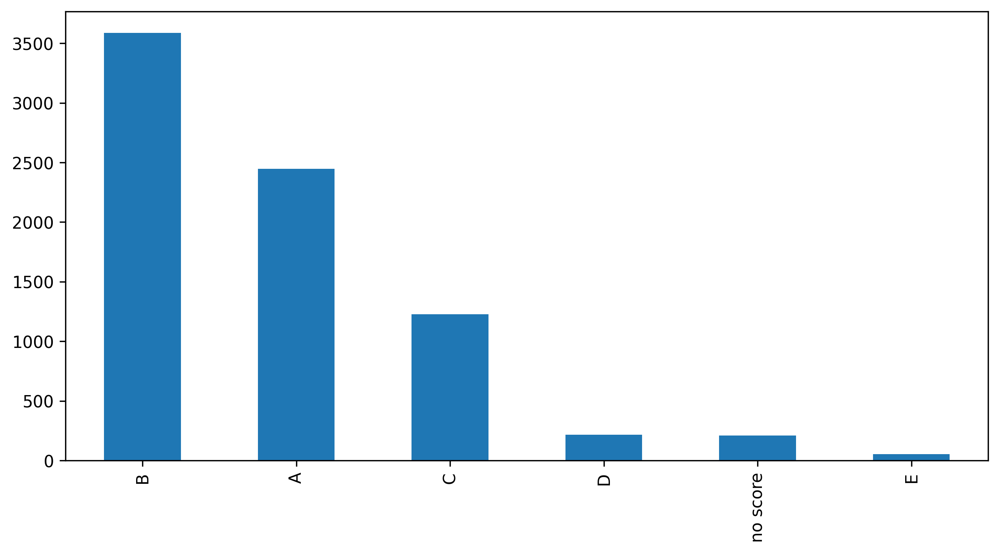

In [7]:
fig, ax = plt.subplots(figsize=(10,5), dpi=300)
my_df['q'].value_counts().plot.bar(ax=ax)
plt.savefig(os.path.join(figures_path, 
                        'Frequency_of_audio_files_per_quality.pdf'),
            format = 'pdf')

In [48]:
my_df[(my_df['q'].str.contains("A") | my_df['q'].str.contains("B"))].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6034 entries, 0 to 7724
Data columns (total 29 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             6034 non-null   int64  
 1   gen            6034 non-null   object 
 2   sp             6034 non-null   object 
 3   ssp            1056 non-null   object 
 4   en             6034 non-null   object 
 5   rec            6034 non-null   object 
 6   cnt            6034 non-null   object 
 7   loc            6034 non-null   object 
 8   lat            5814 non-null   float64
 9   lng            5813 non-null   float64
 10  alt            5740 non-null   object 
 11  type           6034 non-null   object 
 12  url            6034 non-null   object 
 13  file           6034 non-null   object 
 14  file-name      6034 non-null   object 
 15  lic            6034 non-null   object 
 16  q              6034 non-null   object 
 17  length         6034 non-null   object 
 18  time    

# Create a DF with "A" & "B" quality files and inspect

In [8]:
A_B_quality_df = my_df[(my_df['q'].str.contains("A") | my_df['q'].str.contains("B"))].reset_index(drop= True)

In [11]:
#Plotting the frequency of birds filtered by quality "A/B".

fig, ax = plt.subplots(figsize=(150,20), dpi=300)
A_B_quality_df['full_sp_name'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries (audios) per species in the full Xenocanto database")
plt.xlabel('Species')
plt.ylabel('number of records')
# plt.savefig(os.path.join(figures_path, 
#                         'Frequency_of_good_audio_files_per_specie.pdf'),
#             format = 'pdf')

Text(0, 0.5, 'number of records')

In [10]:
#Plotting the recordist "A/B".

fig, ax = plt.subplots(figsize=(50,20), dpi=300)
A_B_quality_df['rec'].value_counts().plot.bar(ax=ax)

<AxesSubplot:>

NOTE: there is an entry called Mystery_mystery repeated quite often.
Lets check it

## Exploring the valids coordenate entries

In [19]:
A_B_quality_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6034 entries, 0 to 6033
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             6034 non-null   int64  
 1   gen            6034 non-null   object 
 2   sp             6034 non-null   object 
 3   ssp            1056 non-null   object 
 4   en             6034 non-null   object 
 5   rec            6034 non-null   object 
 6   cnt            6034 non-null   object 
 7   loc            6034 non-null   object 
 8   lat            5814 non-null   float64
 9   lng            5813 non-null   float64
 10  alt            5740 non-null   object 
 11  type           6034 non-null   object 
 12  url            6034 non-null   object 
 13  file           6034 non-null   object 
 14  file-name      6034 non-null   object 
 15  lic            6034 non-null   object 
 16  q              6034 non-null   object 
 17  length         6034 non-null   object 
 18  time    

In [22]:
A_B_quality_df[(A_B_quality_df['lat'].isna() | A_B_quality_df['lng'].isna())].reset_index(drop= True).info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 221 entries, 0 to 220
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             221 non-null    int64  
 1   gen            221 non-null    object 
 2   sp             221 non-null    object 
 3   ssp            22 non-null     object 
 4   en             221 non-null    object 
 5   rec            221 non-null    object 
 6   cnt            221 non-null    object 
 7   loc            221 non-null    object 
 8   lat            1 non-null      float64
 9   lng            0 non-null      float64
 10  alt            219 non-null    object 
 11  type           221 non-null    object 
 12  url            221 non-null    object 
 13  file           221 non-null    object 
 14  file-name      221 non-null    object 
 15  lic            221 non-null    object 
 16  q              221 non-null    object 
 17  length         221 non-null    object 
 18  time      

NOTE: it looks like around 220 entries have no valids coordinates for ploting. Lets try to plot it.


In [26]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
A_B_quality_df['lat'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries of LATITUDE in the 'clean' df")
plt.xlabel('Latitude')
plt.ylabel('number of entries')
plt.savefig(os.path.join(figures_path, 
                        'latitude_reported.pdf'),
            format = 'pdf')

In [27]:
fig, ax = plt.subplots(figsize=(150,20), dpi=300)
A_B_quality_df['lng'].value_counts().plot.bar(ax=ax)
plt.title("Number of entries of LONGITUDE in the 'clean' df")
plt.xlabel('Longitude')
plt.ylabel('number of entries')
plt.savefig(os.path.join(figures_path, 
                        'longitude_reported.pdf'),
            format = 'pdf')

## Create a new dataset with only entries with valid coordinates

In [12]:
A_B_quality_coor_df = A_B_quality_df[~(A_B_quality_df['lat'].isna() | A_B_quality_df['lng'].isna())].reset_index(drop= True).reset_index(drop= True)
A_B_quality_coor_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5838 entries, 0 to 5837
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             5838 non-null   int64  
 1   gen            5838 non-null   object 
 2   sp             5838 non-null   object 
 3   ssp            1035 non-null   object 
 4   en             5838 non-null   object 
 5   rec            5838 non-null   object 
 6   cnt            5838 non-null   object 
 7   loc            5838 non-null   object 
 8   lat            5838 non-null   float64
 9   lng            5838 non-null   float64
 10  alt            5546 non-null   object 
 11  type           5838 non-null   object 
 12  url            5838 non-null   object 
 13  file           5838 non-null   object 
 14  file-name      5838 non-null   object 
 15  lic            5838 non-null   object 
 16  q              5838 non-null   object 
 17  length         5838 non-null   object 
 18  time    

## Remove recordings withouth bird id

27 entries are unknown birdsongs.
NOTE: could be used for later identification to asses accuracy of the prediction?

In [92]:
A_B_quality_coor_df = A_B_quality_coor_df[~A_B_quality_coor_df['full_ssp_name'].str.contains("Myste")]
A_B_quality_coor_df

,id,gen,sp,ssp,en,rec,cnt,loc,lat,lng,...,also,rmk,bird-seen,playback-used,sono.small,sono.med,sono.large,sono.full,full_sp_name,full_ssp_name
0,231261,Tinamus,tao,NaN,Grey Tinamou,Peter Boesman,Venezuela,"La Mision Limestone hills, Falcon",10.8500,-68.5500,...,[''],ID certainty 100%. (Archiv. tape 20 side A track 29 seq. A),unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231261-small.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231261-med.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231261-large.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231261-full.png,Tinamus_tao,Tinamus_tao_
1,231253,Tinamus,tao,NaN,Grey Tinamou,Peter Boesman,Venezuela,"Nirgua area, San Felipe",10.2500,-68.5000,...,[''],ID certainty 100%. (Archiv. tape 511 side A track 124 seq. A),unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231253-small.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231253-med.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231253-large.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231253-full.png,Tinamus_tao,Tinamus_tao_
2,6189,Tinamus,tao,septentrionalis,Grey Tinamou,Chris Parrish,Venezuela,"Los Alpes, Guatopo NP, Miranda",10.1717,-66.5028,...,[''],Consecutive two-note songs given by the same individual 2 minutes apart in forest interior after sunset.,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQA/ffts/XC6189-small.png,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQA/ffts/XC6189-med.png,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQA/ffts/XC6189-large.png,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQA/ffts/XC6189-full.png,Tinamus_tao,Tinamus_tao_septentrionalis
3,231240,Tinamus,major,NaN,Great Tinamou,Peter Boesman,Venezuela,"Lower Rio Caura area, Bolivar",7.2500,-65.0000,...,[''],ID certainty 100%. (Archiv. tape 55 side B track 15 seq. A),unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231240-small.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231240-med.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231240-large.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC231240-full.png,Tinamus_major,Tinamus_major_
4,226701,Nothocercus,bonapartei,NaN,Highland Tinamou,Peter Boesman,Venezuela,"Rancho Grande area, Aragua",10.3500,-67.7000,...,[''],ID certainty 100%. (Archiv. tape 16 side B track 2 seq. B),unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC226701-small.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC226701-med.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC226701-large.png,//www.xeno-canto.org/sounds/uploaded/OOECIWCSWV/ffts/XC226701-full.png,Nothocercus_bonapartei,Nothocercus_bonapartei_
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5806,6877,Tiaris,bicolor,omissus,Black-faced Grassquit,Nick Athanas,Venezuela,"Cerro Chichiriviche, Falcón",10.8687,-68.3128,...,"['Leptotila verreauxi', 'Thamnophilus doliatus']",Song from what appeared to be an immature male.,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/XRABICUARW/ffts/XC6877-small.png,//www.xeno-canto.org/sounds/uploaded/XRABICUARW/ffts/XC6877-med.png,//www.xeno-canto.org/sounds/uploaded/XRABICUARW/ffts/XC6877-large.png,//www.xeno-canto.org/sounds/uploaded/XRABICUARW/ffts/XC6877-full.png,Tiaris_bicolor,Tiaris_bicolor_omissus
5807,6898,Catamblyrhynchus,diadema,diadema,Plushcap,Nick Athanas,Venezuela,"Pico Humboldt Trail, Parque Nacional Sierra Nevada, Mérida",8.6209,-71.0331,...,"['Hemispingus frontalis', 'Zimmerius improbus']",NaN,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/XRABICUARW/ffts/XC6898-small.png,//www.xeno-canto.org/sounds/uploaded/XRABICUARW/ffts/XC6898-med.png,//www.xeno-canto.org/sounds/uploaded/XRABICUARW/ffts/XC6898-large.png,//www.xeno-canto.org/sounds/uploaded/XRABICUARW/ffts/XC6898-full.png,Catamblyrhynchus_diadema,Catamblyrhynchus_diadema_diadema
5808,445511,Sonus

In [13]:
#counting the total number of birds in the filtered dataset
my_total_ssp = len(A_B_quality_coor_df['full_ssp_name'].unique())
print("There are {:,} unique bird species in the dataset.".format(my_total_ssp))

There are 1,224 unique bird species in the dataset.


# Downloading the audiofiles

'/Users/rubencito/p_experimental/Venezuelan_birds/metadata/xenocanto/column_names_info.csv'

In [18]:
metadata_col_names_df = pd.read_csv(os.path.join(home_path,
             'metadata',
             'xenocanto',
             'column_names_info.csv'))

### Explore the variables and their meaning

In [75]:
A_B_quality_coor_df.columns

Index(['id', 'gen', 'sp', 'ssp', 'en', 'rec', 'cnt', 'loc', 'lat', 'lng',
       'alt', 'type', 'url', 'file', 'file-name', 'lic', 'q', 'length', 'time',
       'date', 'uploaded', 'also', 'rmk', 'bird-seen', 'playback-used',
       'sono.small', 'sono.med', 'sono.large', 'sono.full', 'full_sp_name',
       'full_ssp_name'],
      dtype='object')

In [20]:
pd.set_option('display.max_colwidth', None)
metadata_col_names_df

,var_name,description
0,id,the catalogue number of the recording on xeno-canto
1,gen,the generic name of the species
2,sp,the specific name (epithet) of the species
3,ssp,the subspecies name (subspecific epithet)
4,en,the English name of the species
5,rec,the name of the recordist
6,cnt,the country where the recording was made
7,loc,the name of the locality
8,lat,the latitude of the recording in decimal coordinates
9,lng,the longitude of the recording in decimal coordinates


I will use the varibales 'id', 'en', 'full_ssp_name', 'lat', 'lng', 'type', 'url', 'file'.

In [97]:
A_B_quality_coor_df['file']= 'https:' + A_B_quality_coor_df['file'].str[:]

<ipython-input-97-845e4190d245>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  A_B_quality_coor_df['file']= 'https:' + A_B_quality_coor_df['file'].str[:]


In [98]:
A_B_quality_coor_df[['id', 'en', 'full_ssp_name', 'lat', 
                     'lng', 'type', 'time', 'date', 'file']]

,id,en,full_ssp_name,lat,lng,type,time,date,file
0,231261,Grey Tinamou,Tinamus_tao_,10.8500,-68.5500,long call,07:30,1996-06-22,https://www.xeno-canto.org/231261/download
1,231253,Grey Tinamou,Tinamus_tao_,10.2500,-68.5000,call,18:30,2007-08-15,https://www.xeno-canto.org/231253/download
2,6189,Grey Tinamou,Tinamus_tao_septentrionalis,10.1717,-66.5028,song,1815,1984-12-02,https://www.xeno-canto.org/6189/download
3,231240,Great Tinamou,Tinamus_major_,7.2500,-65.0000,song,18:00,1997-03-26,https://www.xeno-canto.org/231240/download
4,226701,Highland Tinamou,Nothocercus_bonapartei_,10.3500,-67.7000,song,07:15,1995-03-26,https://www.xeno-canto.org/226701/download
...,...,...,...,...,...,...,...,...,...
5806,6877,Black-faced Grassquit,Tiaris_bicolor_omissus,10.8687,-68.3128,song,08:45,2006-08-07,https://www.xeno-canto.org/6877/download
5807,6898,Plushcap,Catamblyrhynchus_diadema_diadema,8.6209,-71.0331,song,08:00,2006-08-14,https://www.xeno-canto.org/6898/download
5808,445511,Soundscape,Sonus_naturalis_,10.0776,-69.2950,flight call,06:00,2018-08-12,https://www.xeno-canto.org/445511/download
5809,246909,Soundscape,Sonus_naturalis_,7.3682,-69.4407,various,00:00,2010-02-01,https://www.xeno-canto.org/246909/download


In [99]:
A_B_quality_coor_df[['id', 'en', 'full_ssp_name', 'lat', 
                     'lng', 'type', 'time', 'date', 'file']].to_csv(os.path.join(home_path,
             'data',
             'xc',
             str(date.today().strftime("%Y%m%d")) + "_" + "A_B_quality_xc.csv"), 
                                                                   sep = ";")

In [95]:
A_B_quality_coor_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5811 entries, 0 to 5810
Data columns (total 31 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             5811 non-null   int64  
 1   gen            5811 non-null   object 
 2   sp             5811 non-null   object 
 3   ssp            1035 non-null   object 
 4   en             5811 non-null   object 
 5   rec            5811 non-null   object 
 6   cnt            5811 non-null   object 
 7   loc            5811 non-null   object 
 8   lat            5811 non-null   float64
 9   lng            5811 non-null   float64
 10  alt            5519 non-null   object 
 11  type           5811 non-null   object 
 12  url            5811 non-null   object 
 13  file           5811 non-null   object 
 14  file-name      5811 non-null   object 
 15  lic            5811 non-null   object 
 16  q              5811 non-null   object 
 17  length         5811 non-null   object 
 18  time    

### Read the last curated dataframe

In [9]:
A_B_quality_coor_df = pd.read_csv(os.path.join(home_path,
             'data',
             'xc',
             '20211004_A_B_quality_xc.csv'), delimiter= ";")



In [82]:
A_B_quality_coor_df.sample(n = 5).sort_values(by = 'date', ascending = False)

,Unnamed: 0,id,en,full_ssp_name,lat,lng,type,time,date,file
1462,1462,167957,Laughing Falcon,Herpetotheres_cachinnans_,10.165400,-69.5186,song,12:30,2013-12-23,https://www.xeno-canto.org/167957/download
1020,1020,219437,Crested Quetzal,Pharomachrus_antisianus_,8.299000,-70.0851,song,00:00,2012-11-11,https://www.xeno-canto.org/219437/download
3853,3853,22414,White Bellbird,Procnias_albus_albus,5.965600,-61.3917,song,08:40,2008-07-09,https://www.xeno-canto.org/22414/download
627,627,227903,Squirrel Cuckoo,Piaya_cayana_,10.666667,-63.7000,song,07:45,2003-07-28,https://www.xeno-canto.org/227903/download
3082,3082,229554,Merida Tapaculo,Scytalopus_meridanus_meridanus,8.150000,-71.9500,rattle call,07:00,1996-12-16,https://www.xeno-canto.org/229554/download


### Loop over the files and download them if they don't exist

In [5]:
xc_data_path = os.path.join(home_path,'data','xc')

In [79]:
for my_id, my_url in zip(A_B_quality_coor_df.id, A_B_quality_coor_df.file):
    dir_name = os.path.join(xc_data_path, str(my_id))
    file_name = os.path.join(dir_name, "xc_id_" + str(my_id) + ".mp3")
    try:
        os.mkdir(dir_name)
        wget.download(str(my_url), file_name)
    except FileExistsError:
        if not os.path.isfile(file_name):
            wget.download(str(my_url), file_name)
        pass
    del dir_name, file_name


    
    

In [26]:
A_B_quality_coor_df.id[0]

231261

### Loading a sample audio and resampling it to 48 kHz

In [107]:
id_file = "227903"

bird = {'id': id_file, 
        'comm_nm': A_B_quality_coor_df[A_B_quality_coor_df["id"] == int(id_file)].en.values[0],
        'sci_nm' : A_B_quality_coor_df[A_B_quality_coor_df["id"] == int(id_file)].full_ssp_name.values[0],
       'lat' : A_B_quality_coor_df[A_B_quality_coor_df["id"] == int(id_file)].lat.values[0],
       'lon' : A_B_quality_coor_df[A_B_quality_coor_df["id"] == int(id_file)].lng.values[0]}

audio_sample_dir = os.path.join(home_path, 
                                'data', 
                                'xc', 
                                id_file)



data, samp_rate = librosa.load(os.path.join(audio_sample_dir, 
                                           'xc_id_' + id_file + '.mp3'),
                               sr=48000)

print(f'\nYour id file is:  {str(bird["id"])} \n\nCommun name is: {bird["comm_nm"]} \n\nScientific name is: {bird["sci_nm"]} \n\nCoord. are: \tlat :{bird["lat"]}; long: {bird["lon"]}')
print('\n\nTotal number of samples: ',data.shape[0])
print('\nSample rate: ',samp_rate)
print('\nLength of file in seconds: ',librosa.get_duration(data, samp_rate, '\n\n'))
apd.Audio(data = data, rate = samp_rate)

/Users/rubencito/.pyenv/versions/3.8.8/lib/python3.8/site-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")



Your id file is:  227903 

Commun name is: Squirrel Cuckoo 

Scientific name is: Piaya_cayana_ 

Coord. are: 	lat :10.6666666667; long: -63.7


Total number of samples:  963340

Sample rate:  48000

Length of file in seconds:  20.069583333333334


In [16]:
apd.Audio(data = data, rate = samp_rate)

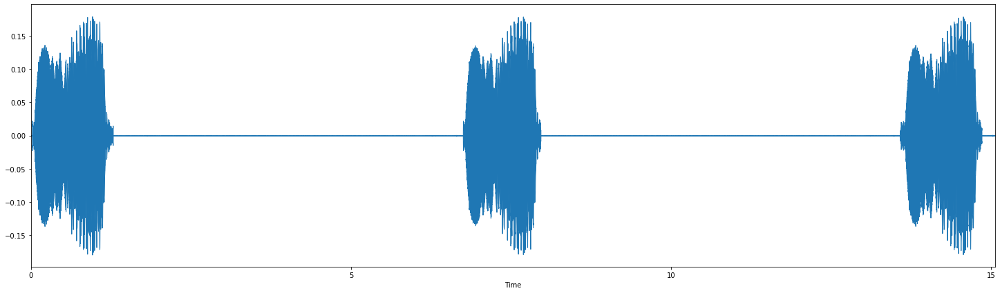

In [60]:
# Display the wavefor of the audio file

trim_data, _ = librosa.effects.trim(data)
fig, ax = plt.subplots(figsize=(25,7))

librosa.display.waveplot(y = trim_data, sr = samp_rate)

### Split 3s sample

In [22]:
start = int(1 * samp_rate)
end = start + 3 * samp_rate
sample_3_s = trim_data[start: end]

Length of file in seconds:  3.0


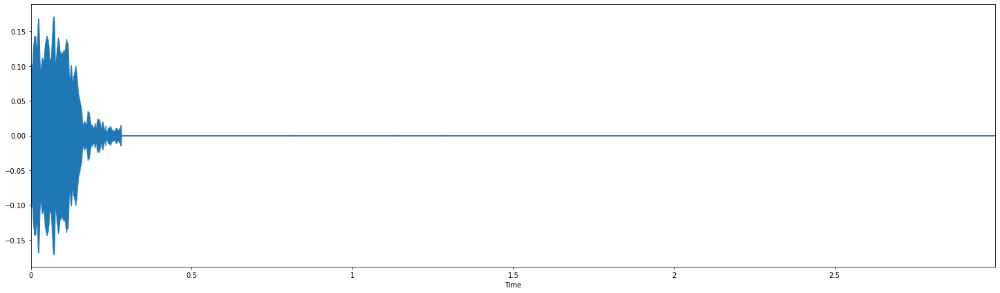

In [23]:
fig, ax = plt.subplots(figsize=(25,7))

librosa.display.waveplot(y = sample_3_s, sr = samp_rate)
print('Length of file in seconds: ',librosa.get_duration(sample_3_s, samp_rate))

In [113]:
apd.Audio(data = sample_3_s, rate = samp_rate)

### Export the 3s audio file

In [24]:
sf.write(file = os.path.join(audio_sample_dir, 
                                           'xc_id_' + id_file + '_3s' + '.wav'),
         data = data,
         samplerate = samp_rate)

### Export the full audio file in 48k sr

In [66]:
sf.write(file = os.path.join(audio_sample_dir, 
                                           'xc_id_' + id_file + '_48k' + '.wav'),
         data = sample_3_s,
         samplerate = samp_rate)

### Resampling in bulk all audiofines to 48k

In [ ]:
sp_rate = 48000
# sort_values(by = 'date', ascending = False)
for my_id in A_B_quality_coor_df.sort_values(by = 'id').id:
    file_name = os.path.join(xc_data_path, str(my_id), "xc_id_" + str(my_id) + ".mp3")
#     print(file_name)
#     print(os.path.dirname(file_name))
    data, samp_rate = librosa.load(file_name,
                               sr=sp_rate)
    sf.write(file = os.path.join(os.path.dirname(file_name), 
                                 'xc_id_' + str(my_id) + '_48k' + '.wav'),
            data = data,
            samplerate = sp_rate)
    del data, samp_rate
    
    

In [ ]:
for my_id, my_url in zip(A_B_quality_coor_df.id, A_B_quality_coor_df.file):
    dir_name = os.path.join(xc_data_path, str(my_id))
    file_name = os.path.join(dir_name, "xc_id_" + str(my_id) + ".mp3")
    try:
        os.mkdir(dir_name)
        wget.download(str(my_url), file_name)
    except FileExistsError:
        if not os.path.isfile(file_name):
            wget.download(str(my_url), file_name)
        pass
    del dir_name, file_name

### NOTE: 
### check species permitted in the BirdNET program that are listed in the Venezuela list

# Ploting the distribution of birds with good quality sound files

In [11]:
# read world map
world_map = gpd.read_file(os.path.join(data_path,
                                      'WB_countries_Admin0_10m',
                                      'WB_countries_Admin0_10m.shp'))
world_map.columns

Index(['OBJECTID', 'featurecla', 'LEVEL', 'TYPE', 'FORMAL_EN', 'FORMAL_FR',
       'POP_EST', 'POP_RANK', 'GDP_MD_EST', 'POP_YEAR', 'LASTCENSUS',
       'GDP_YEAR', 'ECONOMY', 'INCOME_GRP', 'FIPS_10_', 'ISO_A2', 'ISO_A3',
       'ISO_A3_EH', 'ISO_N3', 'UN_A3', 'WB_A2', 'WB_A3', 'CONTINENT',
       'REGION_UN', 'SUBREGION', 'REGION_WB', 'NAME_AR', 'NAME_BN', 'NAME_DE',
       'NAME_EN', 'NAME_ES', 'NAME_FR', 'NAME_EL', 'NAME_HI', 'NAME_HU',
       'NAME_ID', 'NAME_IT', 'NAME_JA', 'NAME_KO', 'NAME_NL', 'NAME_PL',
       'NAME_PT', 'NAME_RU', 'NAME_SV', 'NAME_TR', 'NAME_VI', 'NAME_ZH',
       'WB_NAME', 'WB_RULES', 'WB_REGION', 'Shape_Leng', 'Shape_Area',
       'geometry'],
      dtype='object')

In [12]:
#A_B_quality_df[A_B_quality_df['full_sp_name'].str.contains("Mystery")].info()
venezuela_map = world_map[world_map['NAME_EN'].str.contains("Venezuela")]
venezuela_map

,OBJECTID,featurecla,LEVEL,TYPE,FORMAL_EN,FORMAL_FR,POP_EST,POP_RANK,GDP_MD_EST,POP_YEAR,...,NAME_SV,NAME_TR,NAME_VI,NAME_ZH,WB_NAME,WB_RULES,WB_REGION,Shape_Leng,Shape_Area,geometry
154,155,Admin-0 country,2,Sovereign country,Bolivarian Republic of Venezuela,República Bolivariana de Venezuela,31304016,15,468600.0,2017,...,Venezuela,Venezuela,Venezuela,委內瑞拉,"Venezuela, Republica Bolivariana de","Always have ""R.B. de"" before ""Venezuela""",LCR,88.935407,74.77874,"MULTIPOLYGON (((-60.02099 8.55801, -59.95969 8..."


create  geometry for species

In [13]:
sp_coor_geometry = [Point(xy) for xy in zip(A_B_quality_coor_df["lng"], A_B_quality_coor_df["lat"])]
# Coordinate reference system
crs = {"init" : "epsg:4326"}

# Geo Dataframe
geo_df = gpd.GeoDataFrame(A_B_quality_coor_df, crs=crs, geometry=sp_coor_geometry)

/Users/rubencito/.pyenv/versions/3.8.8/lib/python3.8/site-packages/pyproj/crs/crs.py:68: FutureWarning:

'+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6



In [66]:
# Create ID for species

species_id = A_B_quality_coor_df["full_ssp_name"].value_counts().reset_index()
species_id.insert(0, 'plot_ID', range(0, 0 + len(species_id)))
species_id.rename(columns={"index": "full_ssp_name", "full_ssp_name": "count"}, inplace=True)
# species_id


# Add ID to geo_df

A_B_quality_coor_df = pd.merge(A_B_quality_coor_df, species_id, how="left", on="full_ssp_name")
# A_B_quality_coor_df = gpd.GeoDataFrame(A_B_quality_coor_df)
A_B_quality_coor_df.head()


,id,gen,sp,ssp,en,rec,cnt,loc,lat,lng,...,bird-seen,playback-used,sono.small,sono.med,sono.large,sono.full,full_sp_name,full_ssp_name,plot_ID,count
0,231261,Tinamus,tao,NaN,Grey Tinamou,Peter Boesman,Venezuela,"La Mision Limestone hills, Falcon",10.8500,-68.5500,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_,665,2
1,231253,Tinamus,tao,NaN,Grey Tinamou,Peter Boesman,Venezuela,"Nirgua area, San Felipe",10.2500,-68.5000,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_tao,Tinamus_tao_,665,2
2,6189,Tinamus,tao,septentrionalis,Grey Tinamou,Chris Parrish,Venezuela,"Los Alpes, Guatopo NP, Miranda",10.1717,-66.5028,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,//www.xeno-canto.org/sounds/uploaded/IHIOGGZVQ...,Tinamus_tao,Tinamus_tao_septentrionalis,887,1
3,231240,Tinamus,major,NaN,Great Tinamou,Peter Boesman,Venezuela,"Lower Rio Caura area, Bolivar",7.2500,-65.0000,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Tinamus_major,Tinamus_major_,1127,1
4,226701,Nothocercus,bonapartei,NaN,Highland Tinamou,Peter Boesman,Venezuela,"Rancho Grande area, Aragua",10.3500,-67.7000,...,unknown,unknown,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,//www.xeno-canto.org/sounds/uploaded/OOECIWCSW...,Nothocercus_bonapartei,Nothocercus_bonapartei_,732,2


<AxesSubplot:>

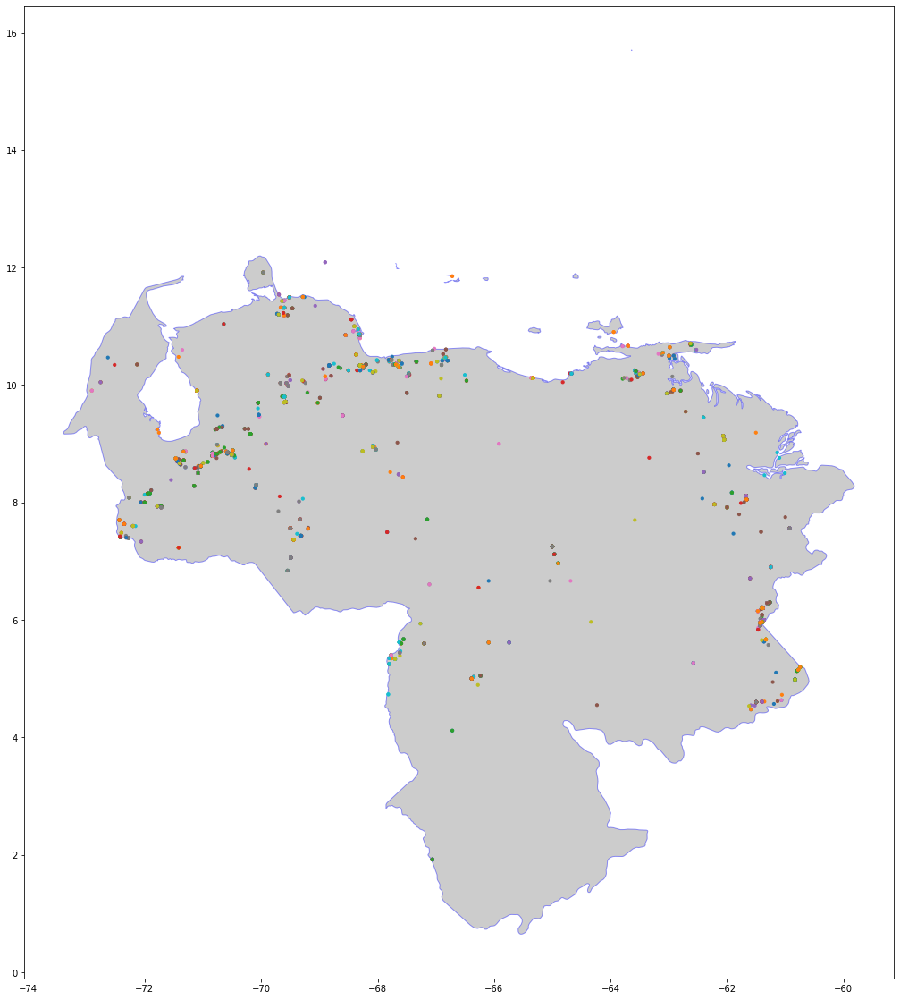

In [16]:
fig, ax = plt.subplots(figsize = (20, 20))

venezuela_map.plot(ax=ax, 
                 alpha=0.4, 
                 color="grey", 
                 edgecolor='blue')


geo_df.plot(ax = ax,
            column = "full_ssp_name",
            markersize=10,
            legend=False)

Create a interactive map

In [91]:
A_B_quality_coor_df.columns

Index(['id', 'gen', 'sp', 'ssp', 'en', 'rec', 'cnt', 'loc', 'lat', 'lng',
       'alt', 'type', 'url', 'file', 'file-name', 'lic', 'q', 'length', 'time',
       'date', 'uploaded', 'also', 'rmk', 'bird-seen', 'playback-used',
       'sono.small', 'sono.med', 'sono.large', 'sono.full', 'full_sp_name',
       'full_ssp_name', 'plot_ID', 'count'],
      dtype='object')

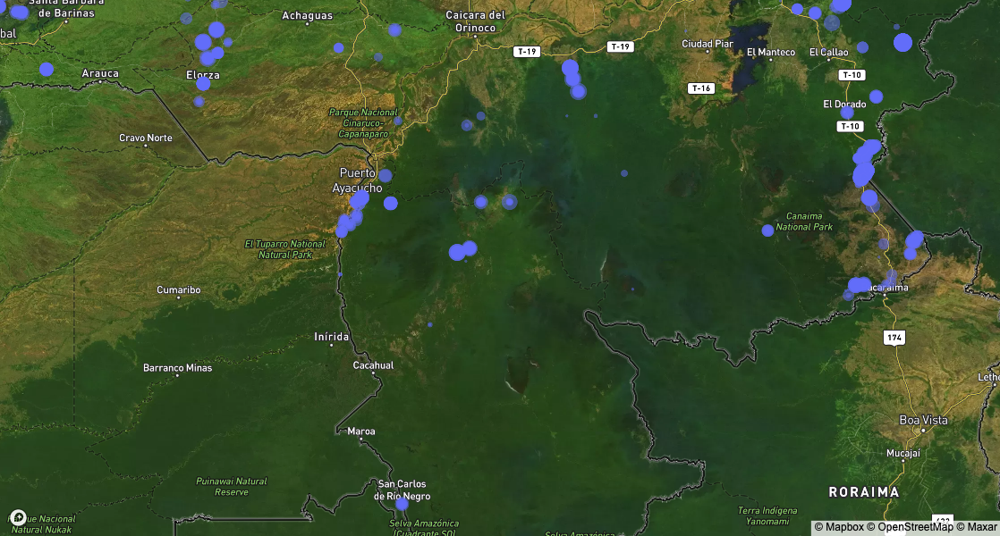

In [104]:
# px.set_mapbox_access_token(open(".mapbox_token").read())
token = open(".mapbox_token").read() # you will need your own token
fig = px.scatter_mapbox(A_B_quality_coor_df,
                        lat=geo_df.geometry.y,
                        lon=geo_df.geometry.x,
                        hover_data=["rec", "loc", "date"],
                        size = "count",
                        size_max=15,
                        opacity = 0.5,
                        hover_name="full_ssp_name",
                        zoom=5)
fig.update_layout(height=600, 
                  mapbox_accesstoken=token,
                mapbox_style = "satellite-streets",
                margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## To do: 
  - Find and add layer for hidrologic resources
  - subset data of northern Orinoco river
  - Extract audio files

In [94]:
# read hidorlogical data from venezuela
data_path
# map_rivers = 

'/Users/rubencito/p_experimental/Venezuelan_birds/data'

In [103]:
gpd.read_file(os.path.join(data_path, 
             "VEN_wat",
            "VEN_water_lines_dcw.shp"))

,F_CODE_DES,HYC_DESCRI,NAM,ISO,NAME_0,geometry
0,River/Stream,Perennial/Permanent,UNK,VEN,Venezuela,"MULTILINESTRING ((-59.94999 8.19268, -59.96569..."
1,River/Stream,Non-Perennial/Intermittent/Fluctuating,UNK,VEN,Venezuela,"LINESTRING (-71.29604 10.97270, -71.27945 10.9..."
2,River/Stream,Perennial/Permanent,UNK,VEN,Venezuela,"LINESTRING (-61.66426 9.39608, -61.66707 9.390..."
3,River/Stream,Perennial/Permanent,UNK,VEN,Venezuela,"LINESTRING (-61.68136 9.39849, -61.68114 9.396..."
4,River/Stream,Perennial/Permanent,UNK,VEN,Venezuela,"LINESTRING (-61.61252 9.23309, -61.61832 9.229..."
...,...,...,...,...,...,...
2968,River/Stream,Perennial/Permanent,UNK,VEN,Venezuela,"LINESTRING (-66.20239 0.83360, -66.19691 0.831..."
2969,River/Stream,Perennial/Permanent,UNK,VEN,Venezuela,"LINESTRING (-66.14608 0.74166, -66.14668 0.743..."
2970,River/Stream,Perennial/Permanent,RIO CAUABURI,VEN,Venezuela,"LINESTRING (-65.57500 0.70281, -65.57102 0.703..."
2971,River/Stream,Perennial/Permanent,UNK,VEN,Venezuela,"MULTILINESTRING ((-72.39925 8.36666, -72.39924..."
